# 🤖 AI Trade Execution Demo
### Interactive Visualization of PPO Agent vs TWAP

This notebook demonstrates a trained Reinforcement Learning agent executing a large order (Liquidation) on real historical data.
We compare its performance against a standard Time-Weighted Average Price (TWAP) benchmark.

In [2]:
import sys
import os
import numpy as np
import pandas as pd
import torch
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import warnings

# Add project root to path
sys.path.append(os.path.abspath(".."))

from src.environment.execution_env import OptimalExecutionEnv
from src.models.ppo_agent import PPOAgent

warnings.filterwarnings('ignore')
plt.style.use('seaborn-v0_8-darkgrid')

## 1. Configuration & Model Loading

In [3]:
# --- Configuration matching eval-tr.py ---
MODEL_PATH = '../models/ppo_execution_best_win_rate_s1_b.pth'
DATA_PATH = '../data/raw/BTCUSDT_1m_test_2024-01-01_to_2024-12-31.csv'

# Execution parameters
INITIAL_INVENTORY = 1000
HORIZON_STEPS = 240       # 4 Hours
CALIB_WINDOW = 200        # Optimized for Real Data

# Physics parameters (The "Easy Mode" settings from eval-tr)
LAMBDA_0 = 0.003          # Lower impact cost
DELTA = 0                 # NO permanent impact
ALPHA = 0.5

print(f"⚙️ Configuration Loaded:")
print(f"   - Horizon: {HORIZON_STEPS} steps")
print(f"   - Impact Cost (Lambda): {LAMBDA_0}")
print(f"   - Permanent Impact (Delta): {DELTA}")

⚙️ Configuration Loaded:
   - Horizon: 240 steps
   - Impact Cost (Lambda): 0.003
   - Permanent Impact (Delta): 0


## 2. Run Simulation Episode

In [4]:
# 1. Initialize Environment
env = OptimalExecutionEnv(
    data_path=DATA_PATH,
    initial_inventory=INITIAL_INVENTORY,
    horizon_steps=HORIZON_STEPS,
    lambda_0=LAMBDA_0,      # Matches eval-tr
    alpha=ALPHA,
    delta=DELTA,            # Matches eval-tr
    calibration_window=CALIB_WINDOW,
    random_start_prob=0.0,  # Ensure random start
    use_real_data=True      # Matches eval-tr
)

# 2. Initialize Agent
# ✅ FIX: Force 'cpu' to avoid RuntimeError in ppo_agent.py line 89
device = 'cpu' 

print(f"🧠 Loading Agent on {device.upper()}...")

hidden_dims = [256, 128, 64] 
agent = PPOAgent(
    state_dim=env.observation_space.shape[0],
    action_dim=env.action_space.n,
    lr=3e-4,
    gamma=1.0,
    epsilon=0.2,
    hidden_dims=hidden_dims,
    device=device 
)

# 3. Load Model Weights
if os.path.exists(MODEL_PATH):
    # Map location ensures weights load to CPU even if saved on GPU
    agent.load(MODEL_PATH)
    print(f"✅ AI Model loaded successfully from: {MODEL_PATH}")
else:
    print(f"❌ Error: Model file not found at {MODEL_PATH}")

Chargement des données depuis ../data/raw/BTCUSDT_1m_test_2024-01-01_to_2024-12-31.csv...
Calibration globale des modèles GARCH et volume...
✓ Calibration globale terminée
🧠 Loading Agent on CPU...
✅ AI Model loaded successfully from: ../models/ppo_execution_best_win_rate_s1_b.pth


## 3. Generate Animation

In [ ]:

# ---------------------------------------------------------
# 1. SEARCH OR SELECT SCENARIO
# ---------------------------------------------------------
# You can now specify a specific Seed OR a specific Data Index to replay.
TARGET_SEED = None       # e.g., 63457
TARGET_INDEX = 93140      # e.g., 12500 (Overrides Seed for data selection)

selected_seed = None

if TARGET_INDEX is not None:
    print(f"🎯 Forcing Data Start Index: {TARGET_INDEX}")
    # Force the environment to start at this specific index
    # We use the sequential backtest feature to lock the index
    if hasattr(env, 'set_sequential_backtest'):
        env.set_sequential_backtest(TARGET_INDEX, HORIZON_STEPS)
    else:
        print("⚠️ Warning: env.set_sequential_backtest not found. Index forcing might fail.")
        
    selected_seed = TARGET_SEED if TARGET_SEED is not None else 42
    
    # Verify the scenario setup
    np.random.seed(selected_seed)
    state, _ = env.reset(seed=selected_seed)
    # ✅ FIX: Use 'random_start_idx' instead of 'current_idx'
    print(f"   ✅ Environment reset at Index: {env.random_start_idx}")


elif TARGET_SEED is not None:
    print(f"🎯 Forcing Seed: {TARGET_SEED}")
    selected_seed = TARGET_SEED
    # Ensure we are in random mode (not sequential)
    if hasattr(env, 'sequential_backtest'): env.sequential_backtest = False
    
    # Verify
    np.random.seed(selected_seed)
    state, _ = env.reset(seed=selected_seed)
    print(f"   ✅ Environment reset with Seed {selected_seed} (Index: {env.current_idx})")

else:
    print("🔎 Searching for Bear Market scenario (Initial Value > TWAP Revenue)...")
    # Ensure we are in random mode
    if hasattr(env, 'sequential_backtest'): env.sequential_backtest = False

    max_attempts = 100
    search_seeds = np.random.randint(0, 100000, size=max_attempts)

    for i, current_seed in enumerate(search_seeds):
        # Force global seed to ensure env picks the same data slice later
        np.random.seed(current_seed)
        
        # Fast run
        state, _ = env.reset(seed=int(current_seed))
        done = False
        cum_twap_check = 0.0
        initial_price = env.prices_history[0]
        
        while not done:
            # Fast forward with deterministic agent
            # ✅ FIX: Unpack tuple (action, log_prob, value)
            action_idx, _, _ = agent.select_action(state, deterministic=True)
            next_state, _, terminated, truncated, info = env.step(action_idx)
            cum_twap_check += info['twap_revenue']
            state = next_state
            done = terminated or truncated
            
        initial_value = initial_price * INITIAL_INVENTORY
        
        if initial_value > cum_twap_check:
            print(f"✅ Found scenario! Seed: {current_seed}")
            print(f"   Initial Val: ${initial_value:,.0f} | TWAP Rev: ${cum_twap_check:,.0f}")
            selected_seed = int(current_seed)
            break
        elif i % 10 ==  0:
            print(f"   Skipping Seed {current_seed} (Bull market)...")

if selected_seed is None:
    print("⚠️ Could not find specific scenario. Using last seed.")
    selected_seed = int(search_seeds[-1])


# ---------------------------------------------------------
# 2. DETAILED RUN WITH SELECTED SEED
# ---------------------------------------------------------
print(f"\n🚀 Starting Detailed Simulation with Seed {selected_seed}...")
np.random.seed(selected_seed) # Ensure exact same data slice
state, _ = env.reset(seed=selected_seed)
done = False

# Data storage - Initialize ALL keys required by animation
history = {
    'step': [], 'price': [], 
    'inventory_agent': [], 'inventory_twap': [],
    'action_qty': [],
    'revenue_agent': [], 'revenue_twap': [],
    'impact_agent': [], 'impact_twap': [], # Required for animation
    'volume': [], 'volatility': []         # Required for animation
}

# Counters
cum_rev_agent = 0.0
cum_rev_twap = 0.0
twap_inventory = INITIAL_INVENTORY
twap_per_step = INITIAL_INVENTORY / HORIZON_STEPS

while not done:
    # 1. Agent Action
    action_idx, _, _ = agent.select_action(state, deterministic=True)
    
    # 2. Step Environment
    next_state, reward, terminated, truncated, info = env.step(action_idx)
    done = terminated or truncated
    
    # 3. Capture Data directly from Env
    cum_rev_agent += info['agent_revenue']
    cum_rev_twap += info['twap_revenue']
    
    # Update TWAP tracking
    twap_inventory = max(0, twap_inventory - twap_per_step)
    
    # --- Calculate Context & Impact for Animation ---
    current_vol = env.volumes_history[-1] if env.volumes_history else 1.0
    
    # Volatility (Sigma)
    if len(env.realized_vols_history) > 0:
        current_realized_vol = env.realized_vols_history[-1]
        current_sigma = env._calculate_rolling_mean(env.realized_vols_history, env.avg_window)
    else:
        current_realized_vol = 0.005
        current_sigma = 0.005

    # Rolling Volume
    if len(env.volumes_history) > 0:
        rolling_vol = env._calculate_rolling_mean(env.volumes_history, env.avg_window)
    else:
        rolling_vol = current_vol if current_vol > 0 else 1.0

    # TWAP Impact Calculation (Theoretical)
    if rolling_vol > 0:
        twap_impact_rel = env._calculate_temporary_impact(
            twap_per_step, 
            current_realized_vol, 
            current_sigma, 
            rolling_vol
        )
    else:
        twap_impact_rel = 0.0
    
    # Store history
    history['step'].append(env.current_step)
    history['price'].append(env.prices_history[-1])
    history['inventory_agent'].append(info['inventory_remaining'])
    history['inventory_twap'].append(twap_inventory)
    history['action_qty'].append(info['quantity_sold'])
    history['revenue_agent'].append(cum_rev_agent)
    history['revenue_twap'].append(cum_rev_twap)
    
    # Store Animation Context
    history['volume'].append(current_vol)
    history['volatility'].append(current_sigma * 10000) # bps
    history['impact_agent'].append(info.get('temp_impact_relative', 0) * 10000) # bps
    history['impact_twap'].append(twap_impact_rel * 10000) # bps
    
    state = next_state

print("🏁 Simulation Complete.")

# Calculate Final Metrics
total_agent = history['revenue_agent'][-1]
total_twap = history['revenue_twap'][-1]

# Implementation Shortfall (IS) vs Arrival Price
# IS = (Avg_Exec_Price - Arrival_Price) / Arrival_Price * 10000 (bps)
arrival_price = history['price'][0]
avg_price_agent = total_agent / INITIAL_INVENTORY
avg_price_twap = total_twap / INITIAL_INVENTORY

is_agent = (avg_price_agent - arrival_price) / arrival_price * 10000
is_twap = (avg_price_twap - arrival_price) / arrival_price * 10000
improvement_bps = is_agent - is_twap

print(f"\n{'='*40}")
print(f"📊 PERFORMANCE SUMMARY")
print(f"{'='*40}")
print(f"💰 Total Revenue Agent: ${total_agent:,.2f}")
print(f"💰 Total Revenue TWAP:  ${total_twap:,.2f}")
print(f"{'-'*40}")
print(f"📈 Agent Avg Price:     ${avg_price_agent:.2f}")
print(f"📈 TWAP Avg Price:      ${avg_price_twap:.2f}")
print(f"{'-'*40}")
print(f"🏆 Performance vs TWAP: {improvement_bps:+.2f} bps")
print(f"{'='*40}")

if improvement_bps > 0:
    print("✅ SUCCESS: The Agent beat the Benchmark!")# filepath: c:\Users\Cameron\OneDrive\Bureau\Ecole\IPP\DS\projet\rl-trade-execution\notebooks\demo_execution copy.ipynb
else:
    print("❌ The Agent did not beat the Benchmark.")

# seeds : 76159    

🎯 Forcing Data Start Index: 93140
🔄 Mode Séquentiel Activé: Start=93140, Step=240


AttributeError: 'OptimalExecutionEnv' object has no attribute 'current_idx'

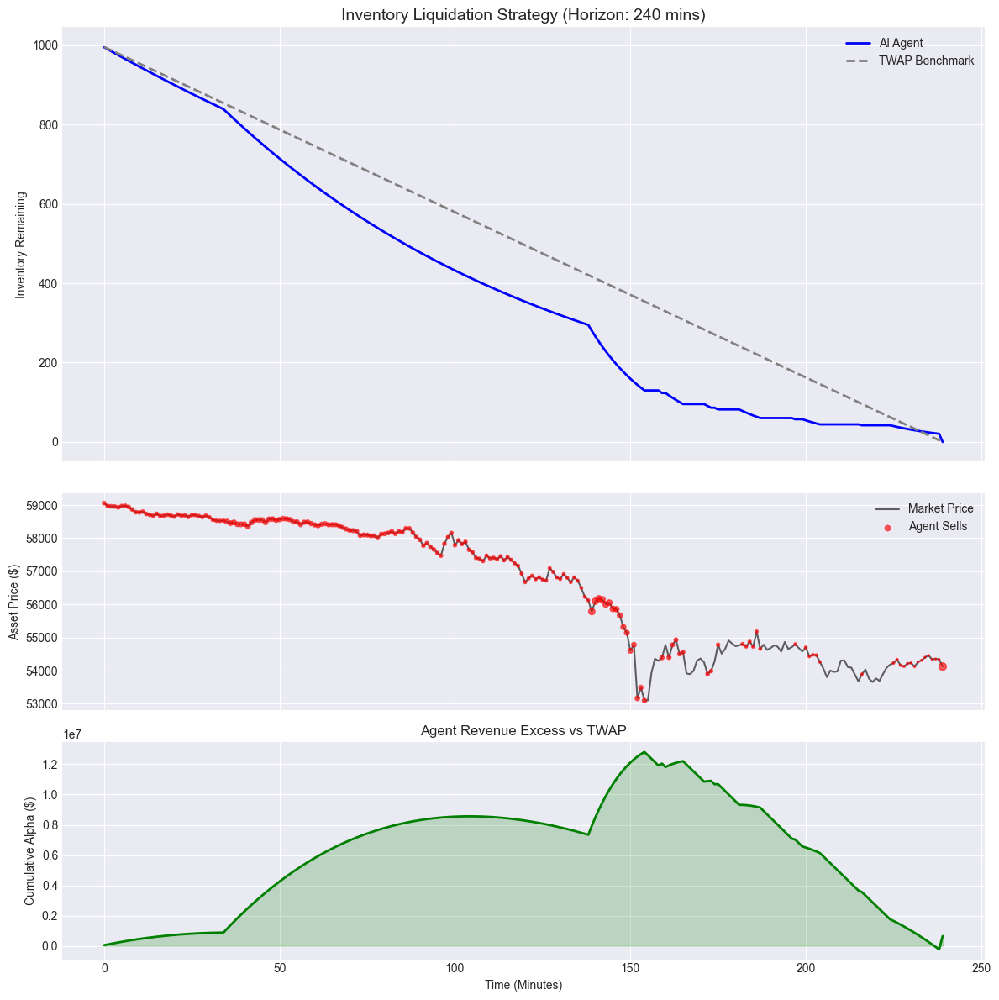

In [42]:
# Create a comprehensive dashboard
fig, axes = plt.subplots(3, 1, figsize=(12, 12), sharex=True, gridspec_kw={'height_ratios': [2, 1, 1]})

# Plot 1: Inventory Evolution
ax0 = axes[0]
ax0.plot(history['inventory_agent'], label='AI Agent', color='blue', linewidth=2)
ax0.plot(history['inventory_twap'], label='TWAP Benchmark', color='gray', linestyle='--', linewidth=2)
ax0.set_ylabel('Inventory Remaining')
ax0.set_title(f'Inventory Liquidation Strategy (Horizon: {HORIZON_STEPS} mins)', fontsize=14)
ax0.legend()

# Plot 2: Price Action & Sells
ax1 = axes[1]
ax1.plot(history['price'], color='black', alpha=0.6, label='Market Price')
# Overlay agent sells as scatter points
sells_idx = [i for i, qty in enumerate(history['action_qty']) if qty > 0]
sells_price = [history['price'][i] for i in sells_idx]
sells_qty = [history['action_qty'][i] for i in sells_idx]
# Size of dot proportional to quantity sold
sizes = [q * 2 for q in sells_qty] 

ax1.scatter(sells_idx, sells_price, s=sizes, color='red', alpha=0.6, label='Agent Sells', zorder=5)
ax1.set_ylabel('Asset Price ($)')
ax1.legend()

# Plot 3: Cumulative Performance (Alpha)
ax2 = axes[2]
alpha_curve = np.array(history['revenue_agent']) - np.array(history['revenue_twap'])
ax2.plot(alpha_curve, color='green' if alpha_curve[-1] > 0 else 'red', linewidth=2)
ax2.fill_between(range(len(alpha_curve)), alpha_curve, 0, alpha=0.2, color='green' if alpha_curve[-1] > 0 else 'red')
ax2.set_ylabel('Cumulative Alpha ($)')
ax2.set_xlabel('Time (Minutes)')
ax2.set_title('Agent Revenue Excess vs TWAP', fontsize=12)

plt.tight_layout()
plt.show()

In [43]:
HORIZON = 240
INVENTORY = INITIAL_INVENTORY


fig = plt.figure(figsize=(14, 14), constrained_layout=True, dpi=80)
gs = fig.add_gridspec(4, 2)

ax_price = fig.add_subplot(gs[0, :])
ax_inv = fig.add_subplot(gs[1, 0])
ax_action = fig.add_subplot(gs[1, 1])
ax_pnl = fig.add_subplot(gs[2, :])
ax_context = fig.add_subplot(gs[3, :]) 
ax_context_vol = ax_context.twinx() # Secondary axis for Volatility

# Initial Empty Plots
line_price, = ax_price.plot([], [], 'b-', label='Market Price', linewidth=2)
line_inv_agent, = ax_inv.plot([], [], 'g-', label='AI Inventory', linewidth=2.5)
line_inv_twap, = ax_inv.plot([], [], 'k--', label='TWAP Inventory', alpha=0.6)
bar_action = ax_action.bar([], [], color='orange', alpha=0.7, label='AI Sell Volume')

# Impact Comparison
line_impact_agent, = ax_pnl.plot([], [], 'r-', label='AI Impact (bps)', linewidth=1.5)
line_impact_twap, = ax_pnl.plot([], [], 'k:', label='TWAP Impact (bps)', linewidth=2.0, alpha=0.8) # Thicker line

# Context (Volume & Volatility)
line_volume, = ax_context.plot([], [], 'c-', label='Volume', alpha=0.4)
fill_volume = ax_context.fill_between([], [], color='cyan', alpha=0.1)
line_volatility, = ax_context_vol.plot([], [], 'orange', label='Volatility (bps)', linewidth=1.5, linestyle='--')

def init():
    # Price
    ax_price.set_xlim(0, HORIZON)
    ax_price.set_ylim(min(history['price'])*0.999, max(history['price'])*1.001)
    ax_price.set_title("📉 Market Price Evolution", fontsize=14, fontweight='bold')
    ax_price.set_ylabel("Price (USDT)")
    ax_price.legend(loc='upper left')
    ax_price.grid(True, alpha=0.3)

    # Inventory
    ax_inv.set_xlim(0, HORIZON)
    ax_inv.set_ylim(0, INVENTORY * 1.05)
    ax_inv.set_title("📦 Inventory Management", fontsize=14, fontweight='bold')
    ax_inv.set_ylabel("Remaining BTC")
    ax_inv.legend()
    ax_inv.grid(True, alpha=0.3)

    # Action
    ax_action.set_xlim(0, HORIZON)
    ax_action.set_ylim(0, max(history['action_qty']) * 1.2 + 1)
    ax_action.set_title("⚡ AI Trading Activity", fontsize=14, fontweight='bold')
    ax_action.set_ylabel("Sold Quantity")
    ax_action.grid(True, alpha=0.3)

    # Impact
    ax_pnl.set_xlim(0, HORIZON)
    max_impact = max(max(history['impact_agent']), max(history['impact_twap']), 5) 
    ax_pnl.set_ylim(0, max_impact * 1.2)
    ax_pnl.set_title("💥 Impact Cost: AI vs TWAP (Lower is Better)", fontsize=14, fontweight='bold')
    ax_pnl.set_ylabel("Impact (bps)")
    ax_pnl.legend(loc='upper right')
    ax_pnl.grid(True, alpha=0.3)
    
    # Context
    ax_context.set_xlim(0, HORIZON)
    ax_context.set_ylim(0, max(history['volume']) * 1.2)
    ax_context.set_title("📊 Market Context: Volume (Blue) vs Volatility (Orange)", fontsize=14, fontweight='bold')
    ax_context.set_ylabel("Volume", color='teal')
    ax_context.set_xlabel("Time (Minutes)")
    
    ax_context_vol.set_ylim(0, max(history['volatility']) * 1.2)
    ax_context_vol.set_ylabel("Volatility (bps)", color='darkorange')
    
    return line_price, line_inv_agent, line_inv_twap, line_impact_agent, line_impact_twap, line_volume, line_volatility

def update(frame):
    x = history['step'][:frame]
    
    # Update Lines
    line_price.set_data(x, history['price'][:frame])
    line_inv_agent.set_data(x, history['inventory_agent'][:frame])
    line_inv_twap.set_data(x, history['inventory_twap'][:frame])
    
    line_impact_agent.set_data(x, history['impact_agent'][:frame])
    line_impact_twap.set_data(x, history['impact_twap'][:frame])
    
    line_volume.set_data(x, history['volume'][:frame])
    line_volatility.set_data(x, history['volatility'][:frame])
    
    # Redraw Bar Chart
    ax_action.cla()
    ax_action.set_xlim(0, HORIZON)
    ax_action.set_ylim(0, max(history['action_qty']) * 1.2 + 1)
    ax_action.set_title("⚡ AI Trading Activity", fontsize=14, fontweight='bold')
    ax_action.grid(True, alpha=0.3)
    ax_action.bar(x, history['action_qty'][:frame], color='orange', alpha=0.7, width=1.0)
    
    # Title
    if frame > 0:
        current_pnl = history['revenue_agent'][frame-1]
        fig.suptitle(f"Step {frame}/{HORIZON} | Price: {history['price'][frame-1]:.2f} | Revenue: ${current_pnl:,.0f}", fontsize=16)
    
    return line_price, line_inv_agent, line_inv_twap, line_impact_agent, line_impact_twap, line_volume, line_volatility

plt.rcParams['animation.embed_limit'] = 60.0 

ani = animation.FuncAnimation(
    fig, update, 
    frames=range(0, len(history['step']), 4), # Skip frames for speed
    init_func=init, 
    blit=False, 
    interval=50
)

plt.close()
print("🎥 Rendering enhanced animation...")
HTML(ani.to_jshtml())



🎥 Rendering enhanced animation...


In [48]:
HORIZON = 240
INVENTORY = INITIAL_INVENTORY


fig = plt.figure(figsize=(14, 14), constrained_layout=True, dpi=80)
gs = fig.add_gridspec(4, 2)

ax_price = fig.add_subplot(gs[0, :])
ax_inv = fig.add_subplot(gs[1, 0])
ax_action = fig.add_subplot(gs[1, 1])
ax_pnl = fig.add_subplot(gs[2, :])
ax_context = fig.add_subplot(gs[3, :]) 
ax_context_vol = ax_context.twinx() # Secondary axis for Volatility

# Initial Empty Plots
line_price, = ax_price.plot([], [], 'b-', label='Market Price', linewidth=2)
line_inv_agent, = ax_inv.plot([], [], 'g-', label='AI Inventory', linewidth=2.5)
line_inv_twap, = ax_inv.plot([], [], 'k--', label='TWAP Inventory', alpha=0.6)
bar_action = ax_action.bar([], [], color='orange', alpha=0.7, label='AI Sell Volume')

# Impact Comparison
line_impact_agent, = ax_pnl.plot([], [], 'r-', label='AI Impact (bps)', linewidth=1.5)
line_impact_twap, = ax_pnl.plot([], [], 'k:', label='TWAP Impact (bps)', linewidth=2.0, alpha=0.8) # Thicker line

# Context (Volume & Volatility)
line_volume, = ax_context.plot([], [], 'c-', label='Volume', alpha=0.4)
fill_volume = ax_context.fill_between([], [], color='cyan', alpha=0.1)
line_volatility, = ax_context_vol.plot([], [], 'orange', label='Volatility (bps)', linewidth=1.5, linestyle='--')

def init():
    # Price
    ax_price.set_xlim(0, HORIZON)
    ax_price.set_ylim(min(history['price'])*0.999, max(history['price'])*1.001)
    ax_price.set_title("📉 Market Price Evolution", fontsize=14, fontweight='bold')
    ax_price.set_ylabel("Price (USDT)")
    ax_price.legend(loc='upper left')
    ax_price.grid(True, alpha=0.3)

    # Inventory
    ax_inv.set_xlim(0, HORIZON)
    ax_inv.set_ylim(0, INVENTORY * 1.05)
    ax_inv.set_title("📦 Inventory Management", fontsize=14, fontweight='bold')
    ax_inv.set_ylabel("Remaining BTC")
    ax_inv.legend()
    ax_inv.grid(True, alpha=0.3)

    # Action
    ax_action.set_xlim(0, HORIZON)
    ax_action.set_ylim(0, max(history['action_qty']) * 1.2 + 1)
    ax_action.set_title("⚡ AI Trading Activity", fontsize=14, fontweight='bold')
    ax_action.set_ylabel("Sold Quantity")
    ax_action.grid(True, alpha=0.3)

    # Impact
    ax_pnl.set_xlim(0, HORIZON)
    max_impact = max(max(history['impact_agent']), max(history['impact_twap']), 5) 
    ax_pnl.set_ylim(0, max_impact * 1.2)
    ax_pnl.set_title("💥 Impact Cost: AI vs TWAP (Lower is Better)", fontsize=14, fontweight='bold')
    ax_pnl.set_ylabel("Impact (bps)")
    ax_pnl.legend(loc='upper right')
    ax_pnl.grid(True, alpha=0.3)
    
    # Context
    ax_context.set_xlim(0, HORIZON)
    ax_context.set_ylim(0, max(history['volume']) * 1.2)
    ax_context.set_title("📊 Market Context: Volume (Blue) vs Volatility (Orange)", fontsize=14, fontweight='bold')
    ax_context.set_ylabel("Volume", color='teal')
    ax_context.set_xlabel("Time (Minutes)")
    
    ax_context_vol.set_ylim(0, max(history['volatility']) * 1.2)
    ax_context_vol.set_ylabel("Volatility (bps)", color='darkorange')
    
    return line_price, line_inv_agent, line_inv_twap, line_impact_agent, line_impact_twap, line_volume, line_volatility

def update(frame):
    x = history['step'][:frame]
    
    # Update Lines
    line_price.set_data(x, history['price'][:frame])
    line_inv_agent.set_data(x, history['inventory_agent'][:frame])
    line_inv_twap.set_data(x, history['inventory_twap'][:frame])
    
    line_impact_agent.set_data(x, history['impact_agent'][:frame])
    line_impact_twap.set_data(x, history['impact_twap'][:frame])
    
    line_volume.set_data(x, history['volume'][:frame])
    line_volatility.set_data(x, history['volatility'][:frame])
    
    # Redraw Bar Chart
    ax_action.cla()
    ax_action.set_xlim(0, HORIZON)
    ax_action.set_ylim(0, max(history['action_qty']) * 1.2 + 1)
    ax_action.set_title("⚡ AI Trading Activity", fontsize=14, fontweight='bold')
    ax_action.grid(True, alpha=0.3)
    ax_action.bar(x, history['action_qty'][:frame], color='orange', alpha=0.7, width=1.0)
    
    # Title
    if frame > 0:
        current_pnl = history['revenue_agent'][frame-1]
        fig.suptitle(f"Step {frame}/{HORIZON} | Price: {history['price'][frame-1]:.2f} | Revenue: ${current_pnl:,.0f}", fontsize=16)
    
    return line_price, line_inv_agent, line_inv_twap, line_impact_agent, line_impact_twap, line_volume, line_volatility

plt.rcParams['animation.embed_limit'] = 60.0 

ani = animation.FuncAnimation(
    fig, update, 
    frames=range(0, len(history['step']), 4), # Skip frames for speed
    init_func=init, 
    blit=False, 
    interval=50
)

plt.close()

# --- SAVE OUTPUT ---
print("💾 Saving animation...")

# Option 1: Save as GIF (Recommended - uses Pillow, usually installed)
#ani.save('execution_demo.gif', writer='pillow', fps=8)
#print("✅ Saved: execution_demo.gif")

# Option 2: Save as MP4 (Requires FFMPEG to be installed on your Windows machine)
ani.save('execution_demo.mp4', writer='ffmpeg', fps=8)
print("✅ Saved: execution_demo.mp4")

print("🎥 Rendering enhanced animation in notebook...")
HTML(ani.to_jshtml())



💾 Saving animation...
✅ Saved: execution_demo.gif
🎥 Rendering enhanced animation in notebook...


In [ ]:
# ---------------------------------------------------------
# HELPER FUNCTIONS FOR SCENARIO TESTING
# ---------------------------------------------------------

def run_and_plot_scenario(target_seed, title_prefix="Scenario"):
    """Runs the simulation for a specific seed and plots the static dashboard."""
    print(f"▶️ Running {title_prefix} (Seed: {target_seed})...")
    
    # 1. Run Simulation
    np.random.seed(target_seed)
    state, _ = env.reset(seed=target_seed)
    done = False
    
    history = {'step': [], 'price': [], 'inventory_agent': [], 'inventory_twap': [], 
               'action_qty': [], 'revenue_agent': [], 'revenue_twap': []}
    
    cum_rev_agent = 0.0
    cum_rev_twap = 0.0
    twap_inventory = INITIAL_INVENTORY
    twap_per_step = INITIAL_INVENTORY / HORIZON_STEPS
    
    while not done:
        action_idx, _, _ = agent.select_action(state, deterministic=True)
        next_state, _, terminated, truncated, info = env.step(action_idx)
        done = terminated or truncated
        
        cum_rev_agent += info['agent_revenue']
        cum_rev_twap += info['twap_revenue']
        twap_inventory = max(0, twap_inventory - twap_per_step)
        
        history['step'].append(env.current_step)
        history['price'].append(env.prices_history[-1])
        history['inventory_agent'].append(info['inventory_remaining'])
        history['inventory_twap'].append(twap_inventory)
        history['action_qty'].append(info['quantity_sold'])
        history['revenue_agent'].append(cum_rev_agent)
        history['revenue_twap'].append(cum_rev_twap)
        state = next_state

    # 2. Calculate Metrics
    total_agent = history['revenue_agent'][-1]
    total_twap = history['revenue_twap'][-1]
    improvement_bps = ((total_agent - total_twap) / total_twap) * 10000
    
    print(f"💰 Agent: ${total_agent:,.0f} | TWAP: ${total_twap:,.0f} | Diff: {improvement_bps:+.2f} bps")

    # 3. Plot Dashboard
    fig, axes = plt.subplots(3, 1, figsize=(12, 10), sharex=True, gridspec_kw={'height_ratios': [2, 1, 1]})
    
    # Inventory
    axes[0].plot(history['inventory_agent'], label='AI Agent', color='blue', linewidth=2)
    axes[0].plot(history['inventory_twap'], label='TWAP', color='gray', linestyle='--', linewidth=2)
    axes[0].set_title(f'{title_prefix}: Inventory Evolution', fontsize=14)
    axes[0].set_ylabel('Inventory')
    axes[0].legend()
    
    # Price & Actions
    axes[1].plot(history['price'], color='black', alpha=0.6, label='Price')
    sells_idx = [i for i, q in enumerate(history['action_qty']) if q > 0]
    axes[1].scatter(sells_idx, [history['price'][i] for i in sells_idx], 
                    s=[history['action_qty'][i]*2 for i in sells_idx], color='red', alpha=0.6, label='Sells')
    axes[1].set_ylabel('Price')
    axes[1].legend()
    
    # Alpha
    alpha = np.array(history['revenue_agent']) - np.array(history['revenue_twap'])
    axes[2].plot(alpha, color='green' if alpha[-1] > 0 else 'red')
    axes[2].fill_between(range(len(alpha)), alpha, 0, alpha=0.2, color='green' if alpha[-1] > 0 else 'red')
    axes[2].set_ylabel('Cumulative Alpha ($)')
    axes[2].set_xlabel('Step')
    
    plt.tight_layout()
    plt.show()

In [ ]:
# ---------------------------------------------------------
# SCENARIO A: THE "FLASH CRASH" (Price Drops > 2%)
# ---------------------------------------------------------
print("🔎 Searching for a CRASH scenario...")

found_seed = None
for seed in range(2000, 5000): # Search a range of seeds
    np.random.seed(seed)
    env.reset(seed=seed)
    
    # Peek at the data slice without running the full sim
    # The env stores the current slice in env.data_slice (if using standard implementation)
    # Or we can just look at prices_history after a fast forward, but let's use the env properties
    
    # Fast extraction of start and end price from the selected slice
    # Note: We assume the env selects a contiguous slice based on the seed
    start_price = env.data.iloc[env.current_idx]['close']
    end_idx = min(env.current_idx + HORIZON_STEPS, len(env.data)-1)
    end_price = env.data.iloc[end_idx]['close']
    
    price_return = (end_price - start_price) / start_price
    
    if price_return < -0.02: # Look for 2% drop
        found_seed = seed
        print(f"✅ Found Crash! Seed {seed}: Return {price_return*100:.2f}%")
        break

if found_seed:
    run_and_plot_scenario(found_seed, title_prefix="📉 FLASH CRASH SCENARIO")
else:
    print("❌ No crash scenario found in search range.")

In [ ]:
# ---------------------------------------------------------
# SCENARIO B: THE "PUMP AND DUMP" (High Volatility)
# ---------------------------------------------------------
print("🔎 Searching for PUMP & DUMP scenario...")

found_seed = None
for seed in range(5000, 10000):
    np.random.seed(seed)
    env.reset(seed=seed)
    
    # Get the slice indices
    start_idx = env.current_idx
    end_idx = min(start_idx + HORIZON_STEPS, len(env.data))
    
    # Extract price array for this slice
    slice_prices = env.data.iloc[start_idx:end_idx]['close'].values
    
    if len(slice_prices) < HORIZON_STEPS: continue

    start_p = slice_prices[0]
    max_p = np.max(slice_prices)
    end_p = slice_prices[-1]
    
    # Criteria: Price goes up at least 1.5%, but ends below start price
    if (max_p > start_p * 1.015) and (end_p < start_p):
        found_seed = seed
        print(f"✅ Found Pump & Dump! Seed {seed}")
        print(f"   Start: {start_p:.2f} -> Peak: {max_p:.2f} -> End: {end_p:.2f}")
        break

if found_seed:
    run_and_plot_scenario(found_seed, title_prefix="🎢 PUMP & DUMP SCENARIO")
else:
    print("❌ No scenario found.")

In [ ]:
# ---------------------------------------------------------
# SCENARIO C: LOW LIQUIDITY (High Impact Cost Risk)
# ---------------------------------------------------------
print("🔎 Searching for LOW LIQUIDITY scenario...")

# Calculate global average volume to know what "low" is
global_avg_vol = env.data['volume'].mean()
print(f"   Global Avg Volume: {global_avg_vol:,.0f}")

found_seed = None
for seed in range(10000, 15000):
    np.random.seed(seed)
    env.reset(seed=seed)
    
    start_idx = env.current_idx
    end_idx = min(start_idx + HORIZON_STEPS, len(env.data))
    
    slice_vol = env.data.iloc[start_idx:end_idx]['volume'].mean()
    
    # Criteria: Average volume in this episode is < 50% of global average
    if slice_vol < (global_avg_vol * 0.5):
        found_seed = seed
        print(f"✅ Found Low Liquidity! Seed {seed}")
        print(f"   Episode Avg Vol: {slice_vol:,.0f} (vs Global {global_avg_vol:,.0f})")
        break

if found_seed:
    run_and_plot_scenario(found_seed, title_prefix="💧 LOW LIQUIDITY SCENARIO")
else:
    print("❌ No scenario found.")# filepath: c:\Users\Cameron\OneDrive\Bureau\Ecole\IPP\DS\projet\rl-trade-execution\notebooks\demo_execution.ipynb
# ---------------------------------------------------------
# SCENARIO C: LOW LIQUIDITY (High Impact Cost Risk)
# ---------------------------------------------------------
print("🔎 Searching for LOW LIQUIDITY scenario...")

# Calculate global average volume to know what "low" is
global_avg_vol = env.data['volume'].mean()
print(f"   Global Avg Volume: {global_avg_vol:,.0f}")

found_seed = None
for seed in range(10000, 15000):
    np.random.seed(seed)
    env.reset(seed=seed)
    
    start_idx = env.current_idx
    end_idx = min(start_idx + HORIZON_STEPS, len(env.data))
    
    slice_vol = env.data.iloc[start_idx:end_idx]['volume'].mean()
    
    # Criteria: Average volume in this episode is < 50% of global average
    if slice_vol < (global_avg_vol * 0.5):
        found_seed = seed
        print(f"✅ Found Low Liquidity! Seed {seed}")
        print(f"   Episode Avg Vol: {slice_vol:,.0f} (vs Global {global_avg_vol:,.0f})")
        break

if found_seed:
    run_and_plot_scenario(found_seed, title_prefix="💧 LOW LIQUIDITY SCENARIO")
else:
    print("❌ No scenario found.")